In [31]:
import vk
session = vk.Session(access_token='60ef112660ef112660ef112689608209fe660ef60ef11263d62ac435ca5b7d42d7fd64c')
vk_api = vk.API(session, v='5.103')
group = 'pomogashkivtpu'
m = vk_api.groups.getMembers(group_id = group)

In [32]:
import time
members = m['items']
count_members = m['count'] // 1000  # т.к. максимальное число членов возвращаемое 1 запросом 1 тысяча, нам необходимо узнать сколько запросов необходимо сделать
for i in range(1, count_members+1):
    members1000 = vk_api.groups.getMembers(group_id=group, offset=i*1000)['items'] # считываем очередную 1000 членов сообщества
    members +=members1000 # прибавляем 1000 к уже имеющимся id членов сообщества
    time.sleep(0.5)
    
print('Количество участников в сообществе {0}: {1}'.format(group,len(members)))

Количество участников в сообществе pomogashkivtpu: 3231


In [33]:
# Function for looking up at user data
def extract_userdata(user):
    status = vk_api.users.get(user_id = user).pop() 
    return status

In [42]:
#Предварительная обработка данных
import time
number_private = 0 # счетчик закрытых профилей
number_deactivated = 0 # счетчик удаленных или забанненых пользователей
for m_key in members:
    status = extract_userdata(m_key) # смотрим данные пользователя
    for status_key in status.keys(): # берем нужное нам поле приватности
        if status_key == 'deactivated': # проверяем является ли профиль удаленным или заблокированным
            number_deactivated += 1
            print(status)
            members.remove(m_key)
            continue
        if status_key == 'is_closed': # проверяем является ли профиль закрытым или нет
            if status[status_key] == True:
                number_private += 1
                members.remove(m_key)
                continue
            
print('Количество приватных профилей в сообществе: ' + str(number_private))
print('Количество удаленных или забанненых профилей в сообществе: ' + str(number_deactivated))
print('Оставшиеся профили: ' + str(len(members)))
print('Проверочная сумма:'+str(number_private+number_deactivated+len(members)))

{'id': 224163648, 'first_name': 'DELETED', 'last_name': '', 'deactivated': 'deleted'}
{'id': 258970430, 'first_name': 'DELETED', 'last_name': '', 'deactivated': 'deleted'}
{'id': 436291656, 'first_name': 'DELETED', 'last_name': '', 'deactivated': 'deleted'}
{'id': 449480212, 'first_name': 'DELETED', 'last_name': '', 'deactivated': 'deleted'}
{'id': 493211335, 'first_name': 'Ivan', 'last_name': 'Obyazatelny', 'deactivated': 'banned'}
{'id': 512761454, 'first_name': 'Tatyana', 'last_name': 'Samayaumnaya', 'deactivated': 'banned'}
{'id': 527643121, 'first_name': 'Petr', 'last_name': 'Chernysh', 'deactivated': 'deleted'}
{'id': 569014254, 'first_name': 'Elena', 'last_name': 'Ignatenko', 'deactivated': 'banned'}
Количество приватных профилей в сообществе: 4
Количество удаленных или забанненых профилей в сообществе: 8
Оставшиеся профили: 2411
Проверочная сумма:2423


In [43]:
len(members)

2411

In [44]:
G = nx.Graph()

In [45]:
G.add_nodes_from(members)
G.nodes()

NodeView((2104199, 3030329, 3365394, 3376422, 3501915, 3781878, 3962448, 4349083, 4848322, 5061187, 5504012, 5516817, 6705812, 6796146, 6845526, 7030008, 7036929, 7790852, 8135312, 8283679, 8431313, 8506258, 8539339, 9029639, 9273271, 9399334, 10242515, 10320011, 10506585, 10518206, 10722179, 11142800, 11255308, 11711869, 11792755, 11810737, 11929048, 12009205, 12197487, 12392362, 13112633, 13518015, 13567314, 13831990, 13904663, 14255166, 14255588, 14431222, 14486990, 14845502, 14869873, 15539095, 15692493, 15706131, 15762137, 16431939, 16464776, 16486619, 16585810, 16586542, 16606119, 16703485, 16714559, 17223802, 17246860, 17552701, 17624051, 17786350, 17802565, 17803245, 17941604, 17953105, 18013481, 18091399, 18145150, 18246047, 18571221, 18572192, 18622880, 18775083, 18832471, 19075576, 19413441, 19588607, 19749707, 20091127, 20543461, 20584182, 20742077, 20750918, 20904722, 21016640, 21376042, 21766461, 22022431, 22085506, 22225932, 22447822, 22525948, 22608915, 23008059, 231753

In [46]:
# Function for looking up at user data
def extract_friends_data(user):
    status = vk_api.friends.get(user_id = user)['items']
    return status

In [47]:
# получаем список всех друзей для каждого члена сообщества
from collections import defaultdict
friends_dict = defaultdict(list) # специальный словарь, где каждому ключу соответсвует list значений
number_errors = 0 # счетчик неуспешно проанализированных пользователей на подписки
for m_key in members:
    friends = []
    try:
        friends = extract_friends_data(m_key)
        for i in friends:
            if i in members:
                friends_dict[m_key].append(i)
    except Exception:
        number_errors += 1

In [48]:
number_errors

0

In [10]:
# dictOfMembers = {}
# for g_key in friends_dict.keys():
#     dictOfMembers[g_key]=len(friends_dict[g_key]) # переводим list id пользователей в число пользователей

In [49]:
for member_key in friends_dict.keys():
    for friend_key in friends_dict[member_key]:
        G.add_edge(member_key, friend_key)

In [50]:
G.edges()

EdgeView([(2104199, 111811310), (3365394, 28202946), (3365394, 378471399), (3376422, 16606119), (3376422, 18246047), (3376422, 46332695), (3376422, 53770702), (3376422, 58328787), (3376422, 59177876), (3376422, 77202580), (3376422, 79173759), (3376422, 83464541), (3376422, 94154556), (3376422, 100157750), (3376422, 104938431), (3376422, 121110583), (3376422, 135648987), (3376422, 156625429), (3376422, 157393651), (3376422, 161272126), (3376422, 178370153), (3376422, 205162294), (3376422, 218493451), (3376422, 228817297), (3501915, 14255166), (3501915, 15706131), (3501915, 17941604), (3501915, 19413441), (3501915, 25781076), (3501915, 26723475), (3501915, 28570817), (3501915, 31365529), (3501915, 33199925), (3501915, 38534469), (3501915, 42244425), (3501915, 43246508), (3501915, 51286155), (3501915, 52079222), (3501915, 53717679), (3501915, 54353448), (3501915, 58038701), (3501915, 58328787), (3501915, 59463327), (3501915, 61918302), (3501915, 62439876), (3501915, 69554553), (3501915, 7

In [52]:
import networkx as nx
import matplotlib.pyplot as plt
%config InlineBackend.figure_format = 'svg'
plt.rcParams['figure.figsize'] = (10, 6)

In [53]:
nx.draw(G, with_labels=False)
plt.show();

In [59]:
len(G.nodes())

2411

In [54]:
deg_cent = nx.degree_centrality(G)
# deg_cent

In [55]:
vk_api.users.get(user_id = max(deg_cent)).pop()

{'id': 575070081,
 'first_name': 'Kamal',
 'last_name': 'Shoev',
 'is_closed': False,
 'can_access_closed': True}

In [57]:
bet_cen = nx.betweenness_centrality(G)

In [58]:
vk_api.users.get(user_id = max(bet_cen)).pop()

{'id': 575070081,
 'first_name': 'Kamal',
 'last_name': 'Shoev',
 'is_closed': False,
 'can_access_closed': True}

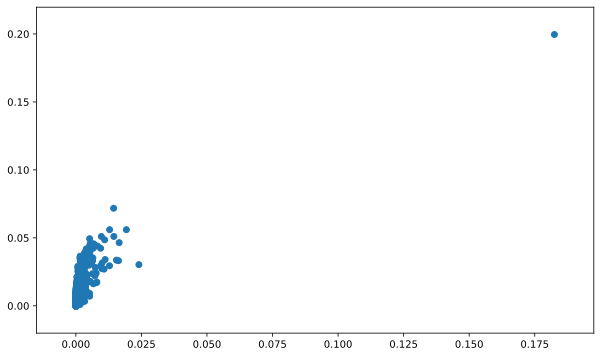

In [60]:
plt.scatter(list(bet_cen.values()), list(deg_cent.values())) 
# Display the plot 
plt.show()

In [61]:
pos = nx.spring_layout(G)
node_color = [20000.0 * G.degree(v) for v in G] 
node_size = [v * 1000 for v in deg_cent.values()] 
plt.figure(figsize=(25,25)) 
nx.draw_networkx(G,pos=pos, with_labels=False, 
node_color=node_color, 
node_size=node_size ) 
plt.axis('off');

In [62]:
pos = nx.spring_layout(G)
bet_cen = nx.betweenness_centrality(G) 
node_color = [20000.0 * G.degree(v) for v in G] 
node_size = [v * 1000 for v in bet_cen.values()] 
plt.figure(figsize=(25,25)) 
nx.draw_networkx(G,pos=pos, with_labels=False, 
node_color=node_color, 
node_size=node_size ) 
plt.axis('off');

In [63]:
clos_cen = nx.closeness_centrality(G)

In [64]:
vk_api.users.get(user_id = max(clos_cen)).pop()

{'id': 575070081,
 'first_name': 'Kamal',
 'last_name': 'Shoev',
 'is_closed': False,
 'can_access_closed': True}

In [65]:
pos = nx.spring_layout(G)
node_color = [20000.0 * G.degree(v) for v in G] 
node_size = [v * 1000 for v in clos_cen.values()] 
plt.figure(figsize=(25,25)) 
nx.draw_networkx(G,pos=pos, with_labels=False, 
node_color=node_color, 
node_size=node_size ) 
plt.axis('off');

In [66]:
eig_cen = nx.eigenvector_centrality(G)

In [67]:
vk_api.users.get(user_id = max(eig_cen)).pop()

{'id': 575070081,
 'first_name': 'Kamal',
 'last_name': 'Shoev',
 'is_closed': False,
 'can_access_closed': True}

In [68]:
pos = nx.spring_layout(G)
node_color = [20000.0 * G.degree(v) for v in G] 
node_size = [v * 1000 for v in eig_cen.values()] 
plt.figure(figsize=(25,25)) 
nx.draw_networkx(G,pos=pos, with_labels=False, 
node_color=node_color, 
node_size=node_size ) 
plt.axis('off');